## Import the Packages

In [1]:
import pandas as pd
import numpy as np
from collections import defaultdict
import seaborn as sns

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from pandas.plotting import register_matplotlib_converters

import yfinance as yf
import os

import numpy as np
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import MinMaxScaler

## Define Important Formulas

In [2]:
def reduce_dataframe(dataframe, indicators):
    """Selects the columns of a specific dataframe and returns the reduced dataframe"""
    #find the intersect between the columns and the selected variables
    intersection_set = set.intersection(set(dataframe.columns.tolist()), set(indicators)) 
    
    #filter the individual dataframes
    dataframe_reduced = dataframe[intersection_set]
    
    return dataframe_reduced 

In [3]:
#normalize the data in order to compare the different indices
def indexize(data_series):
    """Indexes time series to 100 so they all start at the same point"""
    index = (data_series/data_series.iloc[0])*100
    return index

In [4]:
#normalize the data series
def normalize(data_series):
    """Normalized values into a range between 0 and 1"""
    norm_series = (data_series - min(data_series))/(max(data_series)-min(data_series))
    return norm_series

In [5]:
#create a timeseries data plot
def plot_timeseries(country_code, indicator, date_col = 'date'):
    """Returns a timeseries plot of a specific indicator and country"""
    df = master_dataframe[master_dataframe['Country'] == country_code][[date_col, indicator]].dropna()
    if df.shape[0] != 0:
        #filter the indicators overview according to the country_code and indicator
        condition_1 = indicators_overview['country_code'] == country_code
        condition_2 = indicators_overview['indicator_code'] == indicator
        combined = condition_1 & condition_2
        indicator_title = indicators_overview[combined]['description']
        plt.plot(df[date_col], df[indicator], label = countries.loc[country_code, 'country'])
        plt.legend()
        plt.title(indicator_title.iloc[0])
        #plt.title(str(indicators.iloc[indicator, 0]))
        plt.show()
    else:
        pass

In [6]:
#create a timeseries data plot
def save_plot_timeseries(country_code, indicator, directory, date_col = 'date'):
    """Returns a timeseries plot of a specific indicator and country"""
    df = master_dataframe[master_dataframe['Country'] == country_code][[date_col, indicator]].dropna()
    if df.shape[0] != 0:
        #filter the indicators overview according to the country_code and indicator
        condition_1 = indicators_overview['country_code'] == country_code
        condition_2 = indicators_overview['indicator_code'] == indicator
        combined = condition_1 & condition_2
        indicator_title = indicators_overview[combined]['description']
        plt.plot(df[date_col], df[indicator], label = countries.loc[country_code, 'country'])
        plt.legend()
        plt.title(indicator_title.iloc[0])
        plt.savefig(directory + country_code +'/' + str(indicator) + '.png')
    else:
        pass

In [7]:
def request_exchangerate(ticker, period, interval):
    """Returns the closing prices of an exchange rate based on the inputs as a pandas series with datetime index"""
    data = yf.Ticker(ticker).history(period = period, interval = interval)['Close']
    return data

In [8]:
def price_difference_pct(data):
    """calculate the percentage gain between two periods and return the shifted data series"""
    percentage_change = (data.diff()/data.shift(-1))
    return percentage_change.shift(-1)

## Import the Data

### Import Indicators & Countries

In [9]:
#define the indicators for look up
indicators  = pd.read_csv('Data/Documentation/ECD_INDICATOR.csv', index_col = 'code')

In [10]:
#define the country codes for look up
countries = pd.read_csv('Data/Documentation/ECD_COUNTRY_CURRENCY.csv', index_col = 'code')

In [11]:
indicators_overview = pd.read_csv('Data/Documentation/selected_indicators.csv')

In [12]:
countries.shape

(251, 2)

In [13]:
keys = countries.index.to_list()

#delete the nan value
del keys[158]

### Import Data

In [14]:
#initiate a defaultdict to store the dataframes in a dictionary to be accessible by the key(series_id)
dataframes = defaultdict()

#import the csv files and store it in a dictionary
for key in keys:
    dataframes[key] = pd.read_csv('data/Economic_Data/' + key + '.csv', parse_dates = ['date'], index_col= ['date'])
    dataframes[key] = pd.pivot_table(dataframes[key], values = 'value', index = 'date', columns = 'indicator_code').reset_index()
    
    #add a column with the country name
    dataframes[key].insert (1, "Country", key)

In [15]:
dataframes['ZW']

indicator_code,date,Country,1,4,5,7,11,12,17,19,...,188,189,193,194,196,197,198,199,200,205
0,1950-01-01,ZW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1951-01-01,ZW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1952-01-01,ZW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1953-01-01,ZW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1954-01-01,ZW,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
661,2019-10-01,ZW,NaN,NaN,27.65,NaN,NaN,NaN,-46410.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
662,2019-11-01,ZW,NaN,NaN,27.68,NaN,NaN,NaN,-48285.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
663,2019-12-01,ZW,NaN,NaN,28.09,NaN,NaN,NaN,-50286.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
664,2020-01-01,ZW,NaN,NaN,27.18,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,358.2,9.43,4.99,8.07


### Count the Occurances of each indicator code

In [16]:
numbers = []
for key in keys:
    #transform the number into a string to count
    test = dataframes[key].columns.astype(str).to_list()
    numbers.append(test)
    
indicators_num = list(range(1, 206))
indicators_num = [str(i) for i in indicators_num]

indicator_count = defaultdict()
for ind in indicators_num:
    indicator_count[ind] = sum([country.count(ind) for country in numbers])
    #print('ind: ',ind, 'count', sum([country.count(ind) for country in numbers]))

indicator_count_df = pd.DataFrame.from_dict(indicator_count, orient='index')

#label columns
indicator_count_df.columns = ['Count']

In [17]:
indicator_count_df.head(5)

,Count
1,161
2,102
3,36
4,208
5,180


In [18]:
#import the indicator overview
indicator_overview = pd.read_csv('Data/Documentation/EDIA_ECD.csv')

#split the identifier into different categories - A = annual, Q = quarterly, M = Monthly
identifiers = indicator_overview['identifier']

#split the string into substrings using the . as a separator
splited = []
for i in identifiers:
    splited.append(i.split('.'))
    
#column names
header = ['country_code', 'indicator_code', 'Frequency', '3', '4']

#create dataframe of the splited strings
df_splited = pd.DataFrame(splited, columns = header)

In [19]:
#drop unnecessary columns
df = df_splited[['indicator_code', 'Frequency']]

#frequency:
frequency = defaultdict(list)

#store the frequency in the list of the respective indicator
for y, x in zip(df['indicator_code'],df['Frequency']) :
    frequency[y].append(x)


In [20]:
#count the reporting frequencies
overview = []
for key, value in frequency.items():
    overview.append([key, frequency[key].count('A'), frequency[key].count('Q'), frequency[key].count('M')])
    
#create a dataframe of the count
overview = pd.DataFrame(overview, columns = ['indicator', 'Annual', 'Quarterly', 'Monthly'])

#transform the indicators into integer to be able to filter it with the indicator list
overview['indicator'] = overview['indicator'].astype('int64')
overview.head()

,indicator,Annual,Quarterly,Monthly
0,43,174,0,2
1,66,210,22,64
2,67,308,56,419
3,81,425,193,6
4,82,487,281,8


In [21]:
fig = go.Figure(data = go.Scatter(
                x = indicator_count_df.index,
                y = indicator_count_df['Count'],
                mode = 'markers'
))
fig.show()

### Select the Indicators

In [22]:
#select indicators that more than 100 countries have reported
indicators_selected = indicator_count_df[indicator_count_df['Count'] > 100]

#store the selected indicators as a list
indicators_selected = indicators_selected.index.to_list()

print('there are', len(indicators_selected), 'indicators that were reported by more than 100 countries')

there are 116 indicators that were reported by more than 100 countries


In [23]:
#create a dataframe with the frequency count and indicators that more than 100 countries reported
filtered_indicators = overview[overview['indicator'].isin(indicators_selected)]
filtered_indicators = filtered_indicators.sort_values(by = ['indicator'])

#display the frequency count and the indicators
fig = go.Figure(data = [
    go.Bar(name = 'Annual', x = filtered_indicators['indicator'], y = filtered_indicators['Annual']),
    go.Bar(name = 'Quarterly', x = filtered_indicators['indicator'], y = filtered_indicators['Quarterly']),
    go.Bar(name = 'Monthly', x = filtered_indicators['indicator'], y = filtered_indicators['Monthly']),
])
# Change the bar mode
fig.update_layout(barmode='group')
fig.show()


### Filter the Dataframes for the respective Columns

In [24]:
#transform the selected indicators into integers to match it with the dataframe columns
ind_int64 = [int(i) for i in indicators_selected]

In [25]:
#add the country column and the datetime column again
ind_int64.insert(0,'date')
ind_int64.insert(1,'Country')

In [26]:
#filter the dataframes
for key, values in dataframes.items():
    #reduce the columns to the selection
    dataframes[key] = reduce_dataframe(values, ind_int64)
    #fill nan in the dataframe, first backfill and then ffill for recent data
    dataframes[key] = dataframes[key].fillna(method = 'bfill')
    dataframes[key] = dataframes[key].fillna(method = 'ffill')

In [27]:
dataframes['ZW']

indicator_code,1,4,5,7,12,17,19,24,25,33,...,189,193,194,196,197,198,199,200,205,date
0,2.47,0.0,17.54,601.6,0.0,-645.0,2.0,42.011240,112.0,1596.0,...,3.0,84.9,3.24,145.0,1416.0,230.65,8.43,4.81,10.30,1950-01-01
1,2.47,0.0,17.54,601.6,0.0,-645.0,2.0,42.011240,112.0,1596.0,...,3.0,84.9,3.24,145.0,1416.0,230.65,8.43,4.81,10.30,1951-01-01
2,2.47,0.0,17.54,601.6,0.0,-645.0,2.0,42.011240,112.0,1596.0,...,3.0,84.9,3.24,145.0,1416.0,230.65,8.43,4.81,10.30,1952-01-01
3,2.47,0.0,17.54,601.6,0.0,-645.0,2.0,42.011240,112.0,1596.0,...,3.0,84.9,3.24,145.0,1416.0,230.65,8.43,4.81,10.30,1953-01-01
4,2.47,0.0,17.54,601.6,0.0,-645.0,2.0,42.011240,112.0,1596.0,...,3.0,84.9,3.24,145.0,1416.0,230.65,8.43,4.81,10.30,1954-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
661,-9.50,4333.0,27.65,27903.8,52.0,-46410.0,8.0,44.243431,127.0,24743.0,...,3.5,110.2,2.83,158.0,2580.0,358.20,9.43,4.99,8.07,2019-10-01
662,-9.50,4333.0,27.68,27903.8,52.0,-48285.0,8.0,44.243431,127.0,28576.0,...,3.5,110.2,2.83,158.0,2580.0,358.20,9.43,4.99,8.07,2019-11-01
663,-9.50,4333.0,28.09,27903.8,52.0,-50286.0,8.0,44.243431,127.0,27669.0,...,3.5,110.2,2.83,158.0,2580.0,358.20,9.43,4.99,8.07,2019-12-01
664,-9.50,4333.0,27.18,27903.8,52.0,-50286.0,8.0,44.243431,127.0,27669.0,...,3.5,110.2,2.83,158.0,2580.0,358.20,9.43,4.99,8.07,2020-01-01


## Create Master Dataframe

In [28]:
#create a master dataframe with the indicators selected as columns
master_dataframe = pd.DataFrame()

for key in keys:
    master_dataframe = master_dataframe.append(dataframes[key])

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [29]:
master_dataframe.head()

,43,131,171,172,Country,192,193,66,67,197,...,68,74,77,89,124,135,179,142,199,2
0,10.0,61.5,13.0,51.5728,AD,2.78903,100.0,100.0,98.0,2347.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10.0,61.5,14.0,51.5728,AD,2.78903,100.0,100.0,98.0,2347.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10.0,61.5,15.0,51.5728,AD,2.78903,100.0,100.0,98.0,2347.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10.0,61.5,16.0,51.5728,AD,2.78903,100.0,100.0,98.0,2347.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10.0,61.5,17.0,51.5728,AD,2.78903,100.0,100.0,98.0,2347.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Cut Dates before 2020

In [30]:
#define the starting date
begin_date = pd.to_datetime('2000-01-01')

test = master_dataframe['date'] > begin_date
test_df = master_dataframe[test].reset_index()

In [31]:
test_df.head()

,index,43,131,171,172,Country,192,193,66,67,...,68,74,77,89,124,135,179,142,199,2
0,261,10.0,61.5,67.0,27.1864,AD,6.84787,99.7,98.3,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,262,10.0,61.5,67.0,53.2135,AD,8.04336,99.7,98.3,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,263,10.0,61.5,67.0,87.9579,AD,9.64708,99.7,98.3,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,264,10.0,61.5,67.0,66.5998,AD,14.99630,99.7,98.3,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,265,10.0,61.5,67.0,119.8670,AD,18.12870,99.7,98.3,98.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
#create a pickle to have a faster read in
master_dataframe.to_pickle("./master_df.pkl")

In [34]:
master_dataframe = pd.read_pickle("./master_df.pkl")

In [35]:
#define the starting date
begin_date = pd.to_datetime('2000-01-01')

selected_index = master_dataframe['date'] > begin_date
master_dataframe = master_dataframe[selected_index].reset_index(drop = True)

#drop Venezuela, because of too noisy data
master_dataframe = master_dataframe[(master_dataframe['Country'] != 'VE')]

In [36]:
master_dataframe.head()

,43,131,171,172,Country,192,193,66,67,197,...,68,74,77,89,124,135,179,142,199,2
0,10.0,61.5,67.0,27.1864,AD,6.84787,99.7,98.3,98.0,3516.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10.0,61.5,67.0,53.2135,AD,8.04336,99.7,98.3,98.0,3516.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10.0,61.5,67.0,87.9579,AD,9.64708,99.7,98.3,98.0,3516.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10.0,61.5,67.0,66.5998,AD,14.99630,99.7,98.3,98.0,3516.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10.0,61.5,67.0,119.8670,AD,18.12870,99.7,98.3,98.0,3516.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Principle Component Analysis 

In [37]:
data = master_dataframe.drop(['Country', 'date'], axis = 1)
data = data.fillna(0)

In [38]:
#reduce the difference between the values
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(data)

scaled_data = scaler.transform(data)
print(scaled_data.shape)

(82755, 116)


In [39]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 2, svd_solver='full')
pca.fit(scaled_data)

dr_data = pca.transform(scaled_data)
print(dr_data.shape)

(82755, 2)


In [40]:
print(pca.explained_variance_ratio_)

[0.10080059 0.0594049 ]


In [41]:
prepared_data = pd.DataFrame(dr_data, columns = ['pc_1', 'pc_2'])

df_pca = pd.concat([prepared_data, master_dataframe[['Country', 'date']]], axis = 1)
df_pca = df_pca.dropna()
df_pca['year'] = pd.DatetimeIndex(df_pca['date']).year

In [42]:
fig = px.scatter(df_pca,
                 x = 'pc_1', 
                 y = 'pc_2',
                 color = 'Country'
                )

fig.update_layout(
    title="2D PCA, Economic Data",
    xaxis_title="Principle Component 1",
    yaxis_title="Principle Component 1",
)

fig.show()

In [43]:
fig = px.scatter(df_pca,
                 x = 'pc_1', 
                 y = 'pc_2',
                 color = 'year'
                )

fig.update_layout(
    title="2D PCA, Economic Data",
    xaxis_title="Principle Component 1",
    yaxis_title="Principle Component 1",
)

fig.show()

## Create Graphs

In [44]:
#loop through the countries and create a folder for the respective country
for country in keys:
    # Create directory
    dirName = '/Volumes/GoogleDrive/My Drive/Springboard/Capstone Project/Public/Project 2/Graphs/' + country
    try:
        # Create target Directory
        os.mkdir(dirName)
    except FileExistsError:
        pass

In [45]:
ind_num = [int(i) for i in indicators_selected]

In [ ]:
#create a graph for each country and each indicator
directory = '/Volumes/GoogleDrive/My Drive/Springboard/Capstone Project/Public/Project 2/Graphs/'

#create a graph for each country
for country in keys:
    #loop through all of the indicator numbers 
    for indicator in ind_num:
        save_plot_timeseries(country, indicator, directory)
        plt.clf()

/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



# Stationarity

### Dickey Fuller Test

In [44]:
from statsmodels.tsa.stattools import adfuller

In [45]:
indicators = master_dataframe.columns
indicators = indicators.tolist()

#remove Country and date column for the loop
indicators.remove('Country')
indicators.remove('date')

countries_selected = master_dataframe['Country'].unique()

In [46]:
ADF_results = defaultdict()
for country in countries_selected:
    #create an empty dataframe for each country
    df = pd.DataFrame()
    for indicator in indicators:
        try:
            #filter by country and by indicator
            result = adfuller(master_dataframe[master_dataframe['Country'] == country][indicator])
            df[indicator] = list(result[0:2])

            #print('indicator:', indicator, 'ADF Statistic: %f' % result[0])
            #print('p-value: %f' % result[1])

        except:
            pass # doing nothing on exception
    df['Country'] = country
    ADF_results[country] = df

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/regression/linear_model.py:867: RuntimeWarning:

divide by zero encountered in log

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:1294: RuntimeWarning:

invalid value encountered in true_divide



In [47]:
#create a master dataframe with the indicators selected as columns
master_dataframe_ADF = pd.DataFrame()

for country in countries_selected:
    master_dataframe_ADF = master_dataframe_ADF.append(ADF_results[country])

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:7123: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [48]:
master_dataframe_ADF.head()

,43,66,67,81,82,83,84,85,86,88,...,68,74,77,89,124,135,179,142,199,2
0,NaN,-1.792293,NaN,-2.680678,-1.456317,-1.456317,-2.768168,-2.024714,-1.709370,-2.752825,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,0.384295,NaN,0.077442,0.554999,0.554999,0.062967,0.275843,0.426292,0.065335,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,-1.730139,-1.636974,-1.587769,-2.592053,-2.592053,-1.851793,-1.825635,-0.675329,-0.918118,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,0.415655,0.463843,0.489735,0.094651,0.094651,0.355067,0.367811,0.853037,0.781947,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,-1.527229,-1.610110,-1.129191,-1.647923,-1.043850,-1.043850,-1.338725,-1.500134,-1.032203,-1.201530,...,-1.802116,-0.977004,0.938541,-0.549476,-3.024464,-1.58735,-0.780752,NaN,NaN,NaN


In [50]:
#draw a distribution of the p-value per indicator
ADF_p_value = master_dataframe_ADF[master_dataframe_ADF.index == 1]

#define the directory
directory = '/Volumes/GoogleDrive/My Drive/Springboard/Springboard Code/Capstone Project 2/Data/ADF Results/p-value/'

for indicator in indicators:
    plt.hist(ADF_p_value[indicator].dropna(), bins = 25)
    plt.title('P-Value Indicator ' + str(indicator))
    plt.savefig(directory + str(indicator) + '.png')
    plt.clf()

<Figure size 432x288 with 0 Axes>

In [51]:
#check for unit root
ADF_per_indicator = master_dataframe_ADF[master_dataframe_ADF.index == 0]

directory = '/Volumes/GoogleDrive/My Drive/Springboard/Springboard Code/Capstone Project 2/Data/ADF Results/'
#define the directory
#directory = '/Volumes/GoogleDrive/My Drive/Springboard/Springboard Code/Capstone Project 2/Data/
for indicator in indicators:
    plt.hist(ADF_per_indicator[indicator].dropna(), bins = 25)
    plt.title('Indicator ' + str(indicator))
    plt.savefig(directory + str(indicator) + '.png')
    plt.clf()

<Figure size 432x288 with 0 Axes>

In [52]:
statistics_ADF = ADF_per_indicator.describe()
statistics_p_value = ADF_p_value.describe()

In [53]:
statistics_p_value.head()

,43,66,67,81,82,83,84,85,86,88,...,68,74,77,89,124,135,179,142,199,2
count,108.000000,200.000000,204.000000,227.000000,2.240000e+02,2.240000e+02,217.000000,2.100000e+02,210.000000,2.100000e+02,...,165.000000,1.520000e+02,167.000000,106.000000,1.810000e+02,1.760000e+02,186.000000,113.000000,1.630000e+02,92.000000
mean,0.583130,0.425438,0.513401,0.592712,2.600276e-01,2.602193e-01,0.555718,5.564514e-01,0.676181,6.722753e-01,...,0.666082,6.203841e-01,0.618310,0.593859,2.721404e-01,3.185887e-01,0.531548,0.567074,2.712476e-01,0.615551
std,0.278474,0.190780,0.265224,0.266977,2.592334e-01,2.595380e-01,0.261292,2.716340e-01,0.277355,2.771689e-01,...,0.288763,3.080353e-01,0.343506,0.299689,2.536963e-01,2.939973e-01,0.291815,0.336321,2.696133e-01,0.340028
min,0.000004,0.000005,0.000001,0.000222,3.940291e-16,3.940291e-16,0.007693,1.122845e-13,0.001871,8.259912e-21,...,0.000004,1.895540e-26,0.000000,0.010119,5.617961e-08,1.005642e-17,0.000021,0.000533,2.828926e-11,0.000045
25%,0.381631,0.329691,0.307882,0.399619,6.459949e-02,6.459949e-02,0.369473,3.556296e-01,0.510226,5.164843e-01,...,0.522251,3.927288e-01,0.366059,0.342752,7.062626e-02,5.070470e-02,0.265517,0.276999,4.708167e-02,0.299523


In [54]:
#h0 of the Augmented Dickey-Fuller is that there is a unit root
#h1 alternative hypothesis: Augmented Dickey-Fuller - there is no unit root
#because of the quantity of indicators we set off a cutting point of a p-value of 0.6, this should only help to
#have a closer look at the visualization of certain indicators.

critical_indicators = []

for index, num in statistics_p_value.loc['50%'].items():
    if num > 0.6:
        critical_indicators.append(index)
    else:
        pass
#sort the indicators for easier identification 
critical_indicators.sort(reverse = False)
print('total number of critical values: ', len(critical_indicators))

total number of critical values:  62


In [55]:
#manually identified values that do not need to be differentiated
stationary_variables = [1, 5, 12, 19, 24, 25, 43, 44, 45, 50, 51, 54, 55, 58, 63, 73, 82, 94,
                     100, 103, 107, 117, 119, 121, 123, 124, 125, 131, 135, 136, 138, 163,
                     167, 172, 176, 177, 185, 187, 188, 189, 192, 193, 194, 199, 200, 205
                    ]

In [56]:
#remove stationary variables in the list
non_stationary_variables = indicators
for variable in stationary_variables:
    non_stationary_variables.remove(variable)

### Differencing of Non-Stationary Variables

In [19]:
#differencing variables that have been identified as non-stationary variables
master_dataframe[non_stationary_variables] = master_dataframe[non_stationary_variables].diff(axis = 0)

In [20]:
master_dataframe.head()

,131,Country,43,172,171,192,193,66,67,197,...,68,74,77,89,124,135,179,142,199,2
0,61.5,AD,10.0,27.1864,NaN,6.84787,99.7,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,61.5,AD,10.0,53.2135,0.0,8.04336,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,61.5,AD,10.0,87.9579,0.0,9.64708,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,61.5,AD,10.0,66.5998,0.0,14.99630,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,61.5,AD,10.0,119.8670,0.0,18.12870,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Choose Countries and Indicators to Keep

In [21]:
#drop the date column, because it is irrelevant for the groupby
dataframe_date_dropped = master_dataframe.drop(['date'], axis = 1)

#count the number of occurances of each data for each country
df_occurances = dataframe_date_dropped.groupby(['Country']).count()

#### Choose the indicators to drop due to too little data

In [22]:
#count the number of time series for each country
indicators_to_drop = []

#loop through all of the indicators
for indicator in indicators:
    data = df_occurances.loc[:, indicator]
    zeros = data.value_counts(ascending = True)
    try:
        if zeros[0]/zeros.sum() > 0.5:
            indicators_to_drop.append(indicator)
        else:
            pass
    except:
        pass
    
print(len(indicators_to_drop))
indicators_to_drop

8


[56, 92, 146, 149, 173, 89, 142, 2]

#### Choose the countries to drop due to too little data

In [23]:
#count the number of occurances of each indicator
countries_to_drop = []

#loop through all of the countries
for country in countries_selected:
    data = df_occurances.loc[country]
    zeros = data.value_counts(ascending = True)
    try: 
        if zeros[0]/len(data) > 0.5:
            countries_to_drop.append(country)
        else:
            pass
    except:
        pass
    
print(len(countries_to_drop))

54


## Drop the Countries and Indicators with Little Data

In [24]:
#drop the indicators
master_dataframe = master_dataframe.drop(indicators_to_drop, axis = 1)

In [25]:
master_dataframe.head()

,131,Country,43,172,171,192,193,66,67,197,...,5,54,55,68,74,77,124,135,179,199
0,61.5,AD,10.0,27.1864,NaN,6.84787,99.7,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,61.5,AD,10.0,53.2135,0.0,8.04336,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,61.5,AD,10.0,87.9579,0.0,9.64708,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,61.5,AD,10.0,66.5998,0.0,14.99630,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,61.5,AD,10.0,119.8670,0.0,18.12870,99.7,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
#drop the countries
mdf_ready = master_dataframe[~master_dataframe['Country'].isin(countries_to_drop)]

## Import Exchange Rates

In [36]:
#get the selected countries
selected_countries = mdf_ready['Country'].unique()
#get the currencies of the selected countries
currencies = countries[countries.index.isin(selected_countries)]

#only consider the currency and the index(country code)
currencies = currencies.loc[:,['currency']]

#create a dictionary out of the 
currencies = currencies.to_dict()['currency']

In [39]:
df_exchange_rates = pd.DataFrame()

for key, value in currencies.items():
    #create the exchange rate
    currency = 'USD' + str(value) + '=X'
    #request the data of yahoo finance
    exchange_rate = pd.DataFrame(request_exchangerate(currency, 'max', '1mo'))
    exchange_rate['Country'] = key
    
    #add the exchange rate to the dataframe
    df_exchange_rates = pd.concat([df_exchange_rates, exchange_rate])
    


- USDCHW=X: No data found, symbol may be delisted
- USDCOU=X: No data found, symbol may be delisted
- USDWON=X: No data found, symbol may be delisted
- USDSSP=X: No data found, symbol may be delisted
- USDCHW=X: No data found, symbol may be delisted
- USDUSN=X: No data found, symbol may be delisted


In [56]:
df_exchange_rates.to_pickle('USD_Exchange_Rates.pkl')

In [10]:
Exchange_Rates_USD = pd.read_pickle("./USD_Exchange_Rates.pkl")

In [11]:
Exchange_Rates_USD.head()

,Close,Country
Date,,
2003-12-01,3.6715,AE
2004-01-01,3.6715,AE
2004-02-01,3.6715,AE
2004-03-01,3.6715,AE
2004-04-01,3.6717,AE


In [28]:
#merge all the data into one dataframe
master_df = pd.merge(mdf_ready, Exchange_Rates_USD,  how = 'left',
                  left_on=['date','Country'], 
                  right_on = ['Date','Country'])

In [38]:
#export the master dataframe as pickle
master_df.to_pickle('Final_Df.pkl')

In [57]:
master_df = pd.read_pickle("./Final_Df.pkl")

## Forecast Exchange Rates

The goal is to forecast the exchange rate in the subsequent quarter.

In [58]:
#Assign a closing value of 1 to the USD, in order to avoid dropping the value
master_df.loc[master_df['Country'] == 'US', 'Close'] = 1

In [59]:
#select rows where closing price is notna
master_df = master_df[master_df['Close'].notna()]

In [60]:
master_df[master_df['Country'] == 'BR']

,131,Country,43,172,171,192,193,66,67,197,...,54,55,68,74,77,124,135,179,199,Close
6434,67.5,BR,34.0,NaN,0.0,26.5705,98.0,0.0,767.906,0.0,...,1.8,15.4,0.0,0.0,-280.599360,0.87,57.3,0.0,-133.0,2.9010
6435,67.5,BR,34.0,NaN,0.0,26.1996,98.0,0.0,-951.583,0.0,...,1.8,15.4,0.0,0.0,-2277.363160,0.80,56.6,0.0,-133.0,2.9320
6436,68.1,BR,34.0,NaN,2121.0,25.7999,98.8,12.9,-76.214,564.0,...,1.6,17.6,-32329.0,50.0,1732.653200,0.80,56.1,-8.0,-133.0,2.9050
6437,68.1,BR,34.0,NaN,0.0,26.0010,98.8,0.0,2210.898,0.0,...,1.6,17.6,0.0,0.0,2218.118120,0.80,56.0,0.0,-133.0,2.8950
6438,68.1,BR,34.0,NaN,0.0,26.0832,98.8,0.0,-1337.844,0.0,...,1.6,17.6,0.0,0.0,3289.389900,0.78,55.5,0.0,-133.0,2.9300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6626,62.6,BR,34.0,NaN,0.0,26.5119,113.5,0.0,766.262,0.0,...,-2.2,6.9,0.0,0.0,1746.653997,0.45,34.0,0.0,-231.0,4.0157
6627,62.6,BR,34.0,NaN,0.0,26.5119,113.5,0.0,-3953.027,0.0,...,-2.2,6.9,0.0,0.0,-5256.667928,0.41,33.7,0.0,281.0,4.2422
6628,62.6,BR,34.0,NaN,0.0,26.5119,113.5,0.0,1182.319,0.0,...,-2.2,6.9,0.0,0.0,6800.254432,0.41,34.1,0.0,430.0,4.4705
6629,62.6,BR,34.0,NaN,0.0,26.5119,113.5,0.0,3506.165,0.0,...,-2.2,6.9,0.0,0.0,18992.798246,0.41,34.1,0.0,507.0,5.1927


In [61]:
#shift the Closing price one to the back in order to try to forecast it
for country in list(master_df['Country'].unique()):
    master_df.loc[master_df['Country'] == country, 'Close'] = price_difference_pct(master_df.loc[master_df['Country'] == country, 'Close'])
    
    #drop the last two columns of the dataframe, because they contain nan
    master_df.loc[master_df['Country'] == country] = master_df.loc[master_df['Country'] == country][:-2]

In [62]:
master_df[master_df['Country'] == 'BR'][['date', 'Close']]

,date,Close
6434,2003-12-01,0.010671
6435,2004-01-01,-0.009326
6436,2004-02-01,-0.003413
6437,2004-03-01,0.010982
6438,2004-04-01,0.083306
...,...,...
6624,2019-10-01,0.062007
6625,2019-11-01,-0.051742
6626,2019-12-01,0.050665
6627,2020-01-01,0.043966


## Fill NaN - Multivariate feature imputation 

In [63]:
relevant_columns = list(master_df.columns)

In [64]:
#remove irrelevant columns for independent variable
relevant_columns.remove('Country')
relevant_columns.remove('date')
relevant_columns.remove('Close')

In [65]:
imp = IterativeImputer(max_iter=10, random_state=0)

In [66]:
imp.fit(master_df[relevant_columns])

IterativeImputer(add_indicator=False, estimator=None,
                 imputation_order='ascending', initial_strategy='mean',
                 max_iter=10, max_value=None, min_value=None,
                 missing_values=nan, n_nearest_features=None, random_state=0,
                 sample_posterior=False, tol=0.001, verbose=0)

In [67]:
X = imp.transform(master_df[relevant_columns])

In [68]:
X = np.nan_to_num(X)

### Scale the Values

In [69]:
from sklearn.preprocessing import MinMaxScaler

In [70]:
scaler = MinMaxScaler()

In [71]:
scaler.fit(X)

MinMaxScaler(copy=True, feature_range=(0, 1))

In [72]:
X = scaler.transform(X)

# ML Models

### Linear Model - All Factors & Subsequent Month Price Change

In [29]:
y = np.nan_to_num(master_df['Close'])

In [30]:
reg = LinearRegression().fit(X, y)

In [31]:
reg.score(X,y)

0.001850407473466431

In [33]:
X = sm.add_constant(X)
model = sm.OLS(y,X)
results = model.fit()

In [34]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                 -0.002
Method:                 Least Squares   F-statistic:                    0.5478
Date:                Wed, 17 Jun 2020   Prob (F-statistic):               1.00
Time:                        09:17:34   Log-Likelihood:            -1.3500e+05
No. Observations:               32022   AIC:                         2.702e+05
Df Residuals:                   31913   BIC:                         2.711e+05
Df Model:                         108                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2434.5870   7325.596     -0.332      0.740   -1.68e+04    1.19e+04
x1             0.1628      0.813      0.200      0.841      -1.431       1.756
x2            -7.4585     50.944     -0.146      0.884    -107.310      92.393
x3            -7.2901     24.560     -0.297      0.767     -55.428      40.848
x4             2.4386     28.185      0.087      0.931     -52.804      57.682
x5            24.8805     57.249      0.435      0.664     -87.330     137.091
x6             4.4495     10.152      0.438      0.661     -15.448      24.347
x7            -9.4642     11.829     -0.800      0.424     -32.649      13.721
x8            -1.7112     12.372     -0.138      0.890     -25.961      22.539
x9            -0.1373      4.885     -0.028      0.978      -9.712       9.437
x10            2.6147    139.280      0.019      0.985    -270.379     275.608
x11           -3.0078    232.938     -0.013      0.990    -459.576     453.560
x12           47.6167   1621.402      0.029      0.977   -3130.394    3225.628
x13            0.3452     14.419      0.024      0.981     -27.916      28.606
x14            0.2956     12.933      0.023      0.982     -25.054      25.646
x15            0.6109     17.057      0.036      0.971     -32.821      34.043
x16           12.7940     17.601      0.727      0.467     -21.704      47.292
x17           -1.1186     14.909     -0.075      0.940     -30.340      28.103
x18            3.1884    232.199      0.014      0.989    -451.931     458.308
x19          -47.2798   1621.389     -0.029      0.977   -3225.265    3130.706
x20           38.6902     23.129      1.673      0.094      -6.644      84.024
x21           -3.2252     26.920     -0.120      0.905     -55.989      49.539
x22           69.4728     29.305      2.371      0.018      12.033     126.912
x23           -6.9176     18.140     -0.381      0.703     -42.473      28.637
x24           19.6039     30.273      0.648      0.517     -39.733      78.941
x25          136.5213    216.586      0.630      0.528    -287.996     561.039
x26            7.9575     87.554      0.091      0.928    -163.652     179.567
x27          -50.9769     17.948     -2.840      0.005     -86.155     -15.799
x28            7.1713     38.425      0.187      0.852     -68.144      82.487
x29           -0.2878      2.427     -0.119      0.906      -5.044       4.469
x30          -13.0418     40.324     -0.323      0.746     -92.078      65.994
x31           -1.4311      3.623     -0.395      0.693      -8.532       5.669
x32            2.6543     24.739      0.107      0.915     -45.835      51.144
x33           -4.4796     15.877     -0.282      0.778     -35.600      26.641
x34         -142.9176   1203.961     -0.119      0.906   -2502.728    2216.893
x35            3.7264     12.329      0.302      0.762     -20.439      27.892
x3

### Select most relevant columns
Columns that are most relevant are selected.

In [73]:
selected_columns = ['date', 'Country', 101, 104, 168, 4, 105, 96, 72, 100, 148, 121, 5, 119, 193, 103, 116, 177, 107, 19, 62, 200, 55,
                    68, 54, 'Close']

In [74]:
important_data = master_df[selected_columns]

In [75]:
#replace the 0.0 with NaN to forward fill
important_data = important_data.replace(['0', 0], np.nan)

#fill the data forward
important_data = important_data.fillna(method='ffill')

In [76]:
#filter the rows that don't have a closing price
important_data = important_data[important_data['Close'].notna()]

### Linear Model with 22 Factors & Subsequent Quarter Price Change

In [79]:
#define a function to get X and y
def get_xy(dataframe, y_col, periods):
    """get a transformed X and y value by providing a DF and the column of y"""
    #shift the y_col to the back in order to try to forecast it
    for country in list(dataframe['Country'].unique()):
        dataframe.loc[dataframe['Country'] == country, y_col] = dataframe.loc[dataframe['Country'] == country, y_col].rolling(periods, min_periods = 1).sum()
    
    #filter the rows that have a missing value in dependent variable
    dataframe = dataframe[dataframe[y_col].notna()]
    
    #define y
    y = dataframe[y_col]
    
    #drop the columns not needed
    X = dataframe.drop(['date', y_col], axis = 1)
    
    dummies = pd.get_dummies(X['Country'], drop_first = True)
    
    #dummy code the country
    X = pd.concat([X, dummies], axis = 1, sort = False)
    
    #drop the original column afterwards
    X = X.drop(['Country'], axis = 1)

    #fill nan with imputer
    imp = IterativeImputer(max_iter=10, random_state=0)
    imp.fit(X)
    
    #transform x_values
    X_transformed = imp.transform(X)
    
    #rescale X
    scaler = MinMaxScaler()
    scaler.fit(X_transformed)
    X_transformed = pd.DataFrame(scaler.transform(X_transformed))
    X_transformed.columns = list(X.columns)
    
    return X_transformed, y

In [115]:
X, y = get_xy(important_data, 'Close', 3)

In [116]:
#add a constant
X = sm.add_constant(X)
#transform the dataframe into a numpy array
X = X.to_numpy()

/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.



In [117]:
model = sm.OLS(y, X)
results = model.fit()

In [118]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Close   R-squared:                       0.034
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     5.990
Date:                Wed, 22 Jul 2020   Prob (F-statistic):          1.61e-128
Time:                        16:36:23   Log-Likelihood:            -1.8313e+05
No. Observations:               32019   AIC:                         3.666e+05
Df Residuals:                   31833   BIC:                         3.682e+05
Df Model:                         185                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        138.0036     51.390      2.685      0.007      37.276     238.731
x1           430.3035     25.973     16.567      0.000     379.395     481.212
x2           571.2080     40.605     14.068      0.000     491.621     650.795
x3          -206.6208     24.621     -8.392      0.000    -254.878    -158.363
x4          -198.6896     24.280     -8.183      0.000    -246.280    -151.099
x5          -718.0880     49.831    -14.410      0.000    -815.760    -620.416
x6            87.5388     18.376      4.764      0.000      51.521     123.557
x7             4.4269     10.781      0.411      0.681     -16.705      25.559
x8          -157.0147     25.656     -6.120      0.000    -207.301    -106.729
x9            -7.3898     59.315     -0.125      0.901    -123.650     108.871
x10         -695.9110    527.034     -1.320      0.187   -1728.919     337.096
x11           62.5562     28.303      2.210      0.027       7.081     118.031
x12          694.7244    525.541      1.322      0.186    -335.356    1724.804
x13            1.0655     28.404      0.038      0.970     -54.607      56.738
x14            3.8138     33.855      0.113      0.910     -62.544      70.172
x15           -0.0436     25.397     -0.002      0.999     -49.823      49.736
x16            5.1753    102.793      0.050      0.960    -196.302     206.653
x17           -3.0877     54.620     -0.057      0.955    -110.145     103.970
x18          -23.7173     31.375     -0.756      0.450     -85.213      37.779
x19          -22.1837     32.924     -0.674      0.500     -86.715      42.348
x20           -4.2658      8.385     -0.509      0.611     -20.700      12.168
x21          -24.0036     23.542     -1.020      0.308     -70.148      22.140
x22           -1.1342     24.271     -0.047      0.963     -48.706      46.438
x23           -0.1074     17.347     -0.006      0.995     -34.108      33.893
x24           -1.0389      9.118     -0.114      0.909     -18.910      16.832
x25            0.6047      7.606      0.080      0.937     -14.303      15.513
x26            1.2152      7.602      0.160      0.873     -13.684      16.115
x27            1.0513      7.793      0.135      0.893     -14.223      16.326
x28            3.0609      8.532      0.359      0.720     -13.661      19.783
x29            9.7426     10.074      0.967      0.334     -10.004      29.489
x30            1.6769      7.848      0.214      0.831     -13.705      17.058
x31            1.0497      7.745      0.136      0.892     -14.131      16.231
x32            0.7662      7.643      0.100      0.920     -14.215      15.748
x33            0.9099      7.351      0.124      0.901     -13.497      15.317
x34            4.5299      7.812      0.580      0.562     -10.781      19.841
x35            3.0982      7.681      0.403      0.687     -11.956      18.153
x3

### VAR with 22 Factors & Subsequent Quarter Price Change

In [81]:
#define a function to get X and y
def get_timeseries(dataframe, y_col, periods):
    """get transformed timeseries data"""
    
    #shift the y_col to the back in order to try to forecast it
    for country in list(dataframe['Country'].unique()):
        dataframe.loc[dataframe['Country'] == country, y_col] = dataframe.loc[dataframe['Country'] == country, y_col].rolling(periods, min_periods = 1).sum()
    
    #drop the columns not needed
    dataframe = dataframe.drop(['date'], axis = 1)
    
    dummies = pd.get_dummies(dataframe['Country'], drop_first = True)
    
    #dummy code the country
    dataframe = pd.concat([dataframe, dummies], axis = 1, sort = False)
    
    #drop the original column afterwards
    dataframe = dataframe.drop(['Country'], axis = 1)

    #fill nan with imputer
    imp = IterativeImputer(max_iter=10, random_state=0)
    imp.fit(dataframe)
    
    #transform x_values
    df_transformed = imp.transform(dataframe)
    
    #rescale X
    global scaler
    scaler = MinMaxScaler()
    scaler.fit(df_transformed)
    df_transformed = pd.DataFrame(scaler.transform(df_transformed))
    df_transformed.columns = list(dataframe.columns)
    
    return df_transformed

In [82]:
df = get_timeseries(important_data, 'Close', 1)

In [83]:
# Import Statsmodels
from statsmodels.tsa.api import VAR
from statsmodels.tools.eval_measures import rmse, aic
from sklearn.model_selection import train_test_split

In [84]:
train, test = train_test_split(df, train_size=0.75, random_state=1)

In [85]:
#use countries as exogenous variables
selected_countries = list(important_data['Country'].unique())

#remove two elements from the list that were dropped previously
selected_countries.remove('AE')
#selected_countries.remove(np.nan)

In [86]:
#Exogenous variables designates variables were given as an input
#Endogenous variables designates variables in an economic/econometric model that are explained
endogenous_variables = train.drop(selected_countries, axis = 1, inplace = False)
exogenous_variables = train.loc[:, selected_countries]

In [87]:
#train the model
model = VAR(endog = endogenous_variables, exog = exogenous_variables)
for i in [1,2,3,4,5,6,7,8,9]:
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:215: ValueWarning:

An unsupported index was provided and will be ignored when e.g. forecasting.



Lag Order = 1
AIC :  -204.8203261331088
BIC :  -203.30899720192505
FPE :  1.1160042808877357e-89
HQIC:  -204.3302091386039 

Lag Order = 2
AIC :  -204.8012225631222
BIC :  -203.095864046678
FPE :  1.1375326448081022e-89
HQIC:  -204.2481815632779 

Lag Order = 3
AIC :  -204.77509933701444
BIC :  -202.8756970720356
FPE :  1.167645047313769e-89
HQIC:  -204.159129486843 

Lag Order = 4
AIC :  -204.74711667078756
BIC :  -202.65365649235514
FPE :  1.2007864183139306e-89
HQIC:  -204.06821312472312 

Lag Order = 5
AIC :  -204.71771526439946
BIC :  -202.43018300594943
FPE :  1.2366229261314975e-89
HQIC:  -203.97587317629785 

Lag Order = 6
AIC :  -204.69240285108768
BIC :  -202.21078434441068
FPE :  1.2683335635251951e-89
HQIC:  -203.88761737422644 

Lag Order = 7
AIC :  -204.6647288568321
BIC :  -201.98900993207317
FPE :  1.3039346676303177e-89
HQIC:  -203.79699514391027 

Lag Order = 8
AIC :  -204.63299865046113
BIC :  -201.76316513611943
FPE :  1.3459853877222735e-89
HQIC:  -203.702311853599

In [88]:
model_result = model.fit(1)

In [89]:
model_result.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 22, Jul, 2020
Time:                     16:29:11
--------------------------------------------------------------------
No. of Equations:         24.0000    BIC:                   -203.309
Nobs:                     24013.0    HQIC:                  -204.330
Log likelihood:       1.64591e+06    FPE:                1.11600e-89
AIC:                     -204.820    Det(Omega_mle):     9.26427e-90
--------------------------------------------------------------------
Results for equation 101
            coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------
const          0.677570         0.017141           39.530           0.000
exog0          0.000081         0.003598            0.023           0.982
exog1          0.000094         0.003042            0.031           0.975
exog2          0

In [90]:
#Exogenous variables designates variables were given as an input
#Endogenous variables designates variables in an economic/econometric model that are explained
endogenous_variables_test = test.drop(selected_countries, axis = 1, inplace = False)
exogenous_variables_test = test.loc[:, selected_countries]

In [91]:
lag_order = model_result.k_ar
df_forecasts = np.zeros([186,])
for i in range(len(endogenous_variables_test) - 1):
    y = endogenous_variables.values[i : i + 1]
    #select 4 rows of 162 endogenous variables as input
    exog_future = exogenous_variables.values[i : i + 1]
    #forecast the model and selecting the first row of 24 forecasted variables
    forecast = model_result.forecast(y, steps = lag_order, exog_future = exog_future)
    #append the exogenous_variables to the forecasted endogenous variables to filter by country, (186, 0)
    data = np.append(forecast[0], exog_future[0])
    #stack the rows together in a new numpy array
    df_forecasts = np.vstack([df_forecasts, data])

In [92]:
#drop the first row of the dataframe
df_forecasts = pd.DataFrame(df_forecasts).iloc[1:]

In [93]:
df_forecasts.columns = test.columns

## Analyze One Country's Performance

In [94]:
def forecast_vs_reality(df_forecast, df_test, country_code):
    """selects the forecast and actual data of a specific country"""
    #select the forecast for a specific country
    forecast = df_forecast[df_forecast[country_code] == 1].iloc[:,:24].reset_index()
    #select the actual data for a specific country
    actual_data = df_test[df_test[country_code] == 1].iloc[:,:24].reset_index()
    #return both the actual data and the forecast on a country level
    return forecast, actual_data

In [95]:
forecast_BR, BR_real = forecast_vs_reality(df_forecasts, test, 'BR')

In [96]:
BR_real.head()

,index,101,104,168,4,105,96,72,100,148,...,116,177,107,19,62,200,55,68,54,Close
0,3847,0.668600,0.014192,0.075722,0.708610,0.191654,0.300994,0.178229,0.978099,0.112349,...,0.503809,0.000592,0.000028,0.020921,0.645074,0.244489,0.083277,0.560117,0.117674,0.309843
1,3719,0.668866,0.013934,0.075685,0.708608,0.191796,0.300989,0.178164,0.978312,0.112331,...,0.503810,0.000623,0.000021,0.021144,0.645030,0.164329,0.124916,0.560111,0.117683,0.309840
2,3773,0.669523,0.013914,0.075734,0.708612,0.191912,0.301091,0.178225,0.978316,0.112356,...,0.503809,0.000578,0.000024,0.021098,0.645030,0.142285,0.094531,0.560120,0.117669,0.309830
3,3764,0.669058,0.013994,0.075821,0.708615,0.191903,0.301122,0.178234,0.978330,0.112347,...,0.503810,0.000613,0.000025,0.021155,0.645030,0.136273,0.129417,0.560121,0.117671,0.309832
4,3809,0.667895,0.014144,0.075543,0.708615,0.191953,0.300969,0.178059,0.978322,0.112355,...,0.503809,0.000552,0.000029,0.020927,0.644885,0.166333,0.147423,0.560114,0.117671,0.309827


### Plot the actual vs. the forecasted Exchange Rate

In [100]:
def plot_forecast_vs_reality(df_forecast, df_test, country_code, exchange_rate):
    """selects the forecast and actual data of a specific country"""
    #inverse transform the forecast
    columns = df_forecast.columns
    df_forecast = pd.DataFrame(scaler.inverse_transform(df_forecast))
    df_forecast.columns = columns
    #inverse transform the data of the test set
    columns = df_test.columns
    df_test = pd.DataFrame(scaler.inverse_transform(df_test))
    df_test.columns = columns
    #select the forecast for a specific country
    forecast = df_forecast[df_forecast[country_code] == 1].iloc[:,:24].reset_index()
    #select the actual data for a specific country
    actual_data = df_test[df_test[country_code] == 1].iloc[:,:24].reset_index()
    
    #plot the forecast
    plt.plot(forecast[exchange_rate], color = 'red', label = 'forecast')
    plt.plot(actual_data[exchange_rate], color = 'blue', label = 'actual data')
    plt.title('Exchange Rate Forecast vs. Reality ' + str(country_code))
    plt.legend(loc = 'lower right')
    return plt.show()

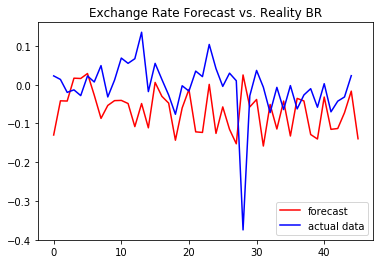

In [101]:
plot_forecast_vs_reality(df_forecasts, test, 'BR', 'Close')

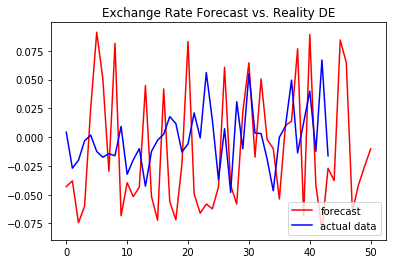

In [102]:
plot_forecast_vs_reality(df_forecasts, test, 'DE', 'Close')

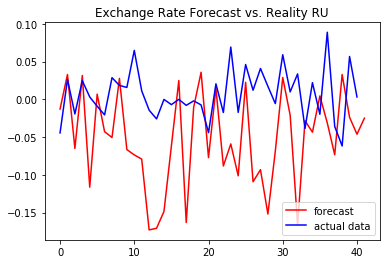

In [103]:
plot_forecast_vs_reality(df_forecasts, test, 'RU', 'Close')